# Подготовка среды

In [125]:
!pip install folium dill weasyprint

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 300.0/300.0 kB 5.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.1/2.1 MB 38.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 3.0/3.0 MB 59.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 849.1/849.1 kB 36.7 MB/s eta 0:00:00


In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from tqdm import tqdm
import folium
import matplotlib.colors as plt_colors

from sklearn.model_selection import train_test_split
from sklearn.preprocessing import OneHotEncoder, TargetEncoder, StandardScaler
from sklearn.compose import ColumnTransformer

from ensembles import RandomForestMSE, GradientBoostingMSE

%matplotlib inline
%config InlineBackend.figure_formats = ['svg']

# Анализ и предобработка данных

In [2]:
df = pd.read_csv('kc_house_data.csv')
df.head()

,id,date,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,...,grade,sqft_above,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15
0,7129300520,20141013T000000,221900.0,3,1.00,1180,5650,1.0,0,0,...,7,1180,0,1955,0,98178,47.5112,-122.257,1340,5650
1,6414100192,20141209T000000,538000.0,3,2.25,2570,7242,2.0,0,0,...,7,2170,400,1951,1991,98125,47.7210,-122.319,1690,7639
2,5631500400,20150225T000000,180000.0,2,1.00,770,10000,1.0,0,0,...,6,770,0,1933,0,98028,47.7379,-122.233,2720,8062
3,2487200875,20141209T000000,604000.0,4,3.00,1960,5000,1.0,0,0,...,7,1050,910,1965,0,98136,47.5208,-122.393,1360,5000
4,1954400510,20150218T000000,510000.0,3,2.00,1680,8080,1.0,0,0,...,8,1680,0,1987,0,98074,47.6168,-122.045,1800,7503


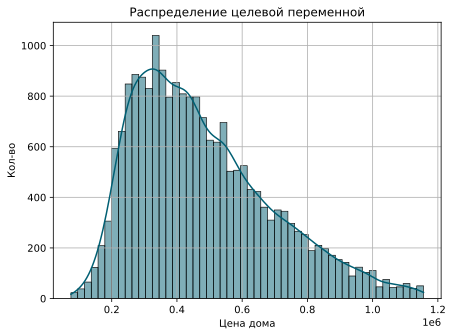

In [3]:
top = np.quantile(df['price'], 0.95)

sns.histplot(x=df['price'][df['price'] < top], kde=True, color='#005F73')
plt.title('Распределение целевой переменной')
plt.xlabel('Цена дома')
plt.ylabel('Кол-во')
plt.grid(True)
plt.tight_layout()
plt.savefig('target_dist.pdf')
plt.show()

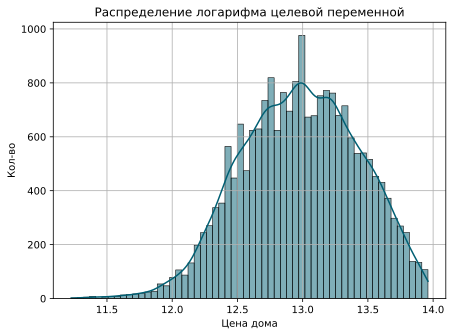

In [4]:
sns.histplot(x=np.log(df['price'][df['price'] < top]), kde=True, color='#005F73')
plt.title('Распределение логарифма целевой переменной')
plt.xlabel('Цена дома')
plt.ylabel('Кол-во')
plt.grid(True)
plt.tight_layout()
plt.savefig('log1p_target_dist.pdf')
plt.show()

In [5]:
df.dtypes

,0
id,int64
date,object
price,float64
bedrooms,int64
bathrooms,float64
sqft_living,int64
sqft_lot,int64
floors,float64
waterfront,int64
view,int64


In [6]:
numerical_features = list(df.drop('price', axis=1).select_dtypes(include='float').columns)
len(numerical_features)

4

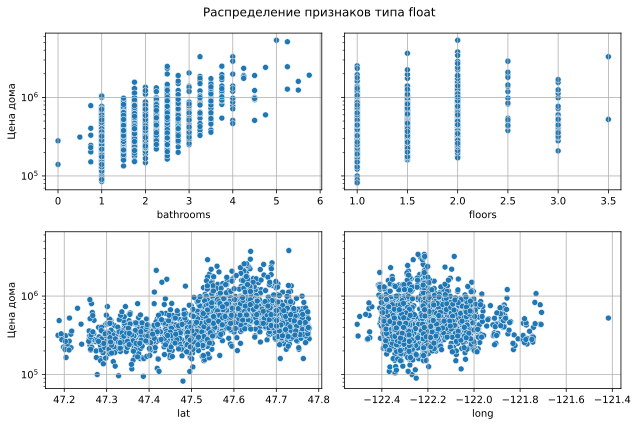

In [7]:
fig, axis = plt.subplots(2, 2, sharey=True, figsize=(9, 6))
fig.suptitle('Распределение признаков типа float')

for i, (feature, ax) in enumerate(zip(numerical_features, axis.flatten())):
    sns.scatterplot(data=df.sample(2000), x=feature, y='price', ax=ax)
    ax.set_yscale('log')
    ax.set_ylabel('Цена дома')
    ax.grid(True)
plt.tight_layout()
plt.show()

In [8]:
df['bathrooms'].unique()

array([1.  , 2.25, 3.  , 2.  , 4.5 , 1.5 , 2.5 , 1.75, 2.75, 3.25, 4.  ,
       3.5 , 0.75, 4.75, 5.  , 4.25, 3.75, 0.  , 1.25, 5.25, 6.  , 0.5 ,
       5.5 , 6.75, 5.75, 8.  , 7.5 , 7.75, 6.25, 6.5 ])

In [9]:
df['date'] = pd.to_datetime(df['date'])

In [10]:
rest_features = list(df.drop('id', axis=1).select_dtypes(exclude='float').columns)
len(rest_features)

15

In [11]:
fig, axis = plt.subplots(4, 4, sharey=True, figsize=(12, 12))
fig.suptitle('Распределение признаков типа int')

for i, (feature, ax) in enumerate(zip(sorted(rest_features), axis.flatten())):
    sns.scatterplot(data=df.sample(2000), x=feature, y='price', ax=ax)
    ax.set_yscale('log')
    ax.set_ylabel('Цена дома')
    ax.grid(True)
    plt.grid(True)
plt.tight_layout()
plt.show()

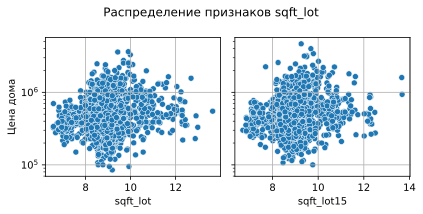

In [12]:
df['sqft_lot'] = np.log1p(df['sqft_lot'])
df['sqft_lot15'] = np.log1p(df['sqft_lot15'])

fig, axis = plt.subplots(1, 2, sharey=True, figsize=(6, 3))
fig.suptitle('Распределение признаков sqft_lot')

feature_list = ['sqft_lot', 'sqft_lot15']
for i, (feature, ax) in enumerate(zip(sorted(feature_list), axis.flatten())):
    sns.scatterplot(data=df.sample(2000), x=feature, y='price', ax=ax)
    ax.set_yscale('log')
    ax.set_ylabel('Цена дома')
    ax.grid(True)
    plt.grid(True)
plt.tight_layout()
plt.show()

In [13]:
def show_circles_on_map(data, latitude_column, longitude_column, hue, colormap):
    location = (data[latitude_column].mean(), data[longitude_column].mean())
    m = folium.Map(location=location)

    codes, unique = pd.factorize(data[hue])
    cmap = plt.get_cmap(colormap)
    norm = plt.Normalize(vmin=0, vmax=len(unique) - 1)
    colors = [cmap(norm(i)) for i in range(len(unique))]
    colors = [f'rgb({int(color[0]*255)}, {int(color[1]*255)}, {int(color[2]*255)})' for color in colors]
    for (_, row), code in zip(data.iterrows(), codes):
        folium.Circle(
            radius=100,
            location=(row[latitude_column], row[longitude_column]),
            color=colors[code],
            fill_color=colors[code],
            fill=True
        ).add_to(m)
    return m

In [14]:
%%capture
m = show_circles_on_map(df.sample(5000), "lat", "long", "zipcode", "jet")
m.save('zipcode_map.html')

In [15]:
m

In [16]:
ax = sns.scatterplot(data=df, x='long', y='lat', hue=np.log1p(df['price']), palette='viridis')
norm = plt.Normalize(np.log1p(df['price']).min(), np.log1p(df['price']).max())
sm = plt.cm.ScalarMappable(cmap="viridis", norm=norm)
sm.set_array([])

ax.get_legend().remove()
ax.figure.colorbar(sm, ax=ax)

plt.title('Распределение цен на дома\nв зависимости от их расположения')
plt.grid(True)
plt.tight_layout()
plt.savefig('heatmap.pdf')
plt.show()

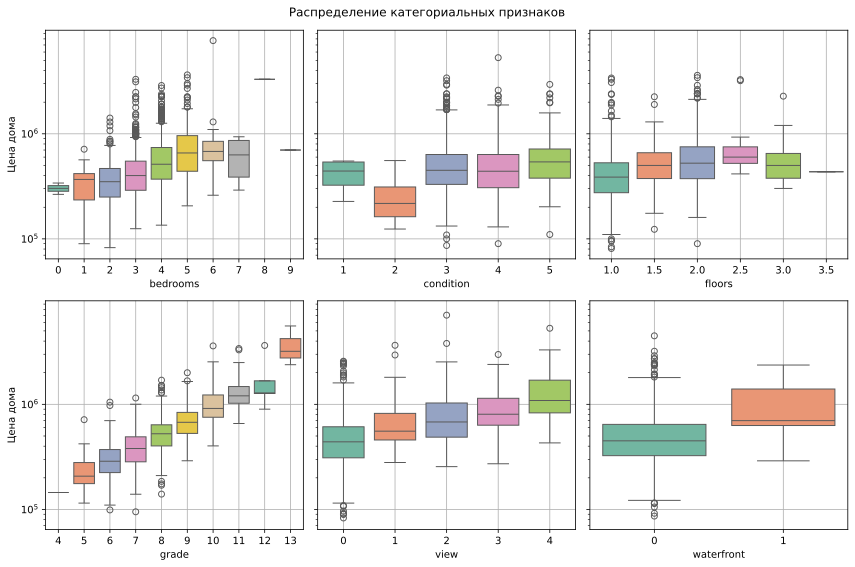

In [17]:
fig, axis = plt.subplots(2, 3, sharey=True, figsize=(12, 8))
fig.suptitle('Распределение категориальных признаков')

feature_list = ['bedrooms', 'condition', 'floors', 'grade', 'view', 'waterfront']
for i, (feature, ax) in enumerate(zip(sorted(feature_list), axis.flatten())):
    sns.boxplot(data=df.sample(2000), x=feature, y='price', hue=feature, legend=False, ax=ax, palette='Set2')
    ax.set_yscale('log')
    ax.set_ylabel('Цена дома')
    ax.grid(True)
    plt.grid(True)
plt.tight_layout()
plt.show()

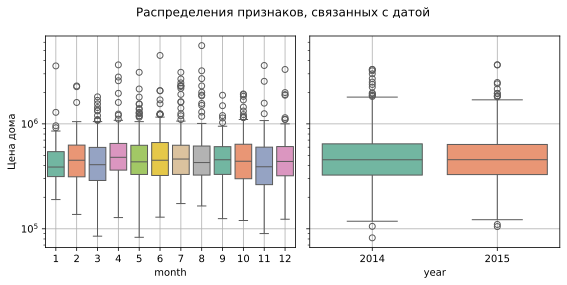

In [18]:
df['month'] = df['date'].dt.month
df['year'] = df['date'].dt.year

fig, axis = plt.subplots(1, 2, sharey=True, figsize=(8, 4))
fig.suptitle('Распределения признаков, связанных с датой')

feature_list = ['month', 'year']
for i, (feature, ax) in enumerate(zip(sorted(feature_list), axis.flatten())):
    sns.boxplot(data=df.sample(2000), x=feature, y='price', hue=feature, legend=False, ax=ax, palette='Set2')
    ax.set_yscale('log')
    ax.set_ylabel('Цена дома')
    ax.grid(True)
    plt.grid(True)
plt.tight_layout()
plt.savefig('date_features.pdf')
plt.show()

In [19]:
numerical_features = ['bathrooms', 'lat', 'long','sqft_above', 'sqft_basement', 'sqft_living', 'sqft_living15', 'sqft_lot', 'sqft_lot15']
categorical_features = ['bedrooms', 'floors', 'waterfront', 'view', 'condition', 'grade', 'yr_built', 'yr_renovated', 'zipcode']

df[categorical_features].nunique()

,0
bedrooms,13
floors,6
waterfront,2
view,5
condition,5
grade,12
yr_built,116
yr_renovated,70
zipcode,70


In [20]:
df[['yr_built', 'yr_renovated']].describe()

,yr_built,yr_renovated
count,21613.000000,21613.000000
mean,1971.005136,84.402258
std,29.373411,401.679240
min,1900.000000,0.000000
25%,1951.000000,0.000000
50%,1975.000000,0.000000
75%,1997.000000,0.000000
max,2015.000000,2015.000000


In [21]:
df['yr_renovated'][df['yr_renovated'] > 0].describe()

,yr_renovated
count,914.000000
mean,1995.827133
std,15.517107
min,1934.000000
25%,1987.000000
50%,2000.000000
75%,2007.000000
max,2015.000000


In [22]:
df['yr_built'] = pd.cut(df['yr_built'], bins=np.arange(1900, 2021, 10))
df['yr_renovated'] = pd.cut(df['yr_renovated'], bins=[0] + list(np.arange(1930, 2021, 10)))

codes, uniques = pd.factorize(df['yr_built'])
df['yr_built'] = codes + 2

codes, uniques = pd.factorize(df['yr_renovated'])
df['yr_renovated'] = codes + 2

In [23]:
df[['yr_built', 'yr_renovated']].describe()

,yr_built,yr_renovated
count,21613.000000,21613.000000
mean,6.702864,1.130199
std,3.080418,0.728813
min,1.000000,1.000000
25%,4.000000,1.000000
50%,6.000000,1.000000
75%,9.000000,1.000000
max,13.000000,10.000000


In [24]:
len(categorical_features)

9

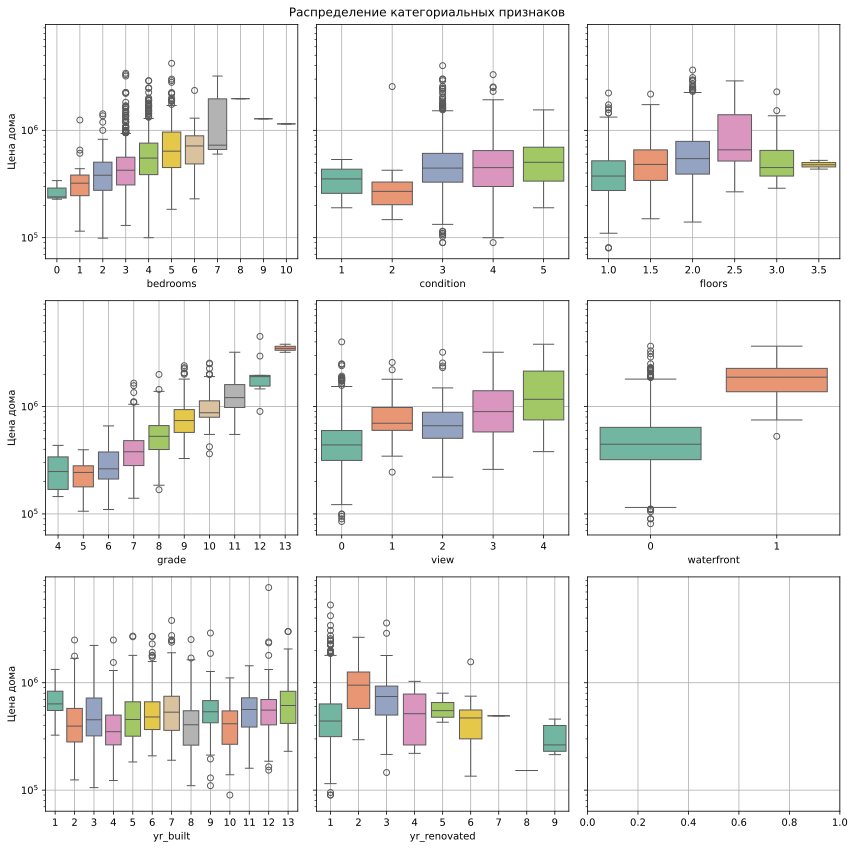

In [25]:
fig, axis = plt.subplots(3, 3, sharey=True, figsize=(12, 12))
fig.suptitle('Распределение категориальных признаков')

feature_list = [f for f in categorical_features if f != 'zipcode']
for i, (feature, ax) in enumerate(zip(sorted(feature_list), axis.flatten())):
    sns.boxplot(data=df.sample(2000), x=feature, y='price', hue=feature, legend=False, ax=ax, palette='Set2')
    ax.set_yscale('log')
    ax.set_ylabel('Цена дома')
    ax.grid(True)
    plt.grid(True)
plt.tight_layout()
plt.savefig('cat_features.pdf')
plt.show()

In [26]:
len(numerical_features)

9

In [27]:
fig, axis = plt.subplots(3, 3, sharey=True, figsize=(12, 12))
fig.suptitle('Распределение численных признаков')

for i, (feature, ax) in enumerate(zip(sorted(numerical_features), axis.flatten())):
    ax.grid(True)
    sns.scatterplot(data=df.sample(2000), x=feature, y='price', ax=ax, color='#005F73', edgecolor='#0A9396')
    ax.set_yscale('log')
    ax.set_ylabel('Цена дома')

plt.tight_layout()
plt.savefig('numerical_features.pdf')
plt.show()

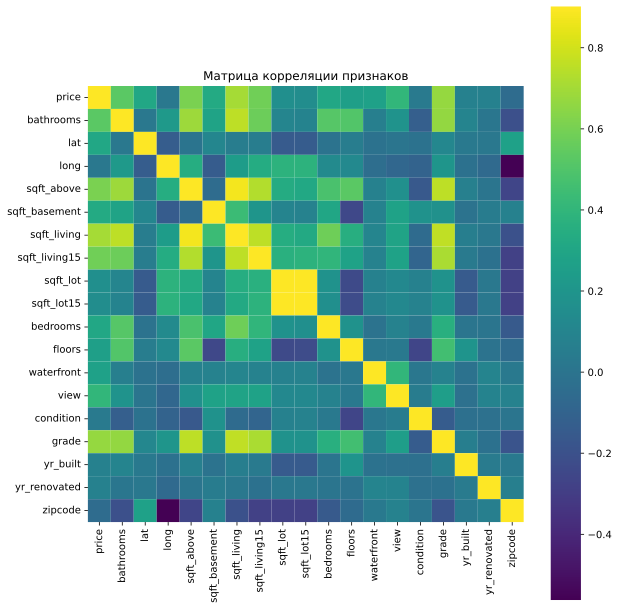

In [28]:
corr = df[['price'] + numerical_features + categorical_features].corr()

plt.figure(figsize=(9, 9))
plt.title('Матрица корреляции признаков')
sns.heatmap(corr, cmap = "viridis", vmax=0.9, square=True)
plt.tight_layout()
plt.savefig('corr.pdf')
plt.show()

In [29]:
numerical_features = ['bathrooms', 'lat', 'long','sqft_above', 'sqft_basement', 'sqft_living', 'sqft_lot']
categorical_features = ['bedrooms', 'floors', 'waterfront', 'view', 'condition', 'grade', 'yr_built', 'yr_renovated', 'zipcode']

In [30]:
y = np.array(df['price'])
df.drop('price', axis=1, inplace=True)

In [31]:
X_train, X_val, y_train, y_val = train_test_split(df.drop('id', axis=1), y, random_state=42, test_size=0.3)

In [32]:
column_transformer = ColumnTransformer([
    ('ohe', OneHotEncoder(handle_unknown='ignore'), categorical_features),
    ('scaler', StandardScaler(), numerical_features)
], remainder='drop')

In [33]:
X_train = column_transformer.fit_transform(X_train, y_train)
X_val = column_transformer.transform(X_val)

In [34]:
X_train.shape

(15129, 142)

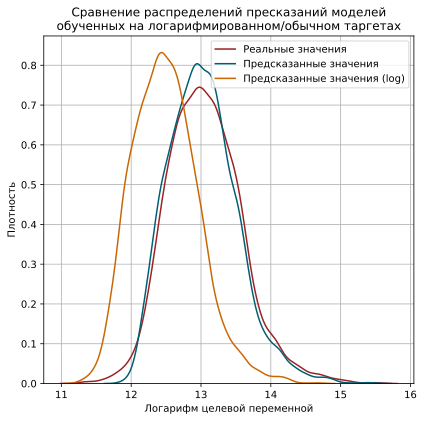

In [35]:
tree_params = {
    'max_features': 70,
    'max_depth': 10
}
clf = GradientBoostingMSE(30, learning_rate=0.1, tree_params=tree_params)
_ = clf.fit(X_train, y_train)
y_pred = clf.predict(X_val)

logy_train = np.log1p(y_train)
clf = GradientBoostingMSE(30, learning_rate=0.1, tree_params=tree_params)
_ = clf.fit(X_train, logy_train)
logy_pred = clf.predict(X_val)

plt.figure(figsize=(6, 6))
plt.title('Сравнение распределений пресказаний моделей\nобученных на логарифмированном/обычном таргетах')
sns.kdeplot(np.log1p(y_val), label="Реальные значения", color='#9B2226')
sns.kdeplot(np.log1p(y_pred), label="Предсказанные значения", color='#005F73')
sns.kdeplot(logy_pred, label="Предсказанные значения (log)", color='#CA6702')
plt.ylabel('Плотность')
plt.xlabel('Логарифм целевой переменной')
plt.grid(True)
plt.legend()
plt.tight_layout()
plt.savefig('w_vs_wo_log.pdf')
plt.show()

# Вспомогательные функции

In [36]:
def examine(model_class, ntrees, grid, name, tree_params,
            save=False, filename=None, xlabel=None, title=None):
    train_res = list()
    val_res = list()
    time_res = list()

    for param in tqdm(grid):
        tree_params[name] = param
        clf = model_class(ntrees, tree_params=tree_params)
        hist, times = clf.fit(X_train, y_train, X_val, y_val, trace=True)
        val_res.append(hist['val'][-1])
        train_res.append(hist['train'][-1])
        time_res.append(np.sum(times))

    plt.figure(figsize=(5, 5))
    plt.title(f'Зависимость RMSE от\n{title}')
    xticks = [param if param is not None else 'None' for param in grid]
    plt.plot(xticks, val_res, label='validation', marker='.', linewidth=2, color='#CA6702')
    plt.plot(xticks, train_res, label='train', marker='.', linewidth=2, color='#005F73')
    plt.xlabel(f'{xlabel}')
    plt.ylabel('RMSE')
    plt.grid(True)
    plt.legend()
    plt.tight_layout()
    if save and filename:
        plt.savefig(f'{filename}_rmse.pdf')
    plt.show()

    plt.figure(figsize=(5, 5))
    plt.title(f'Зависимость времени работы алгоритма от\n{title}')
    plt.plot(xticks, time_res, marker='.', linewidth=2, color='#9B2226')
    plt.xlabel(f'{xlabel}')
    plt.ylabel('Время, с')
    plt.grid(True)
    plt.tight_layout()
    if save and filename:
        plt.savefig(f'{filename}_time.pdf')
    plt.show()

In [37]:
def examine_trees_amount(model_class, ntrees, tree_params, label=None,
                         save=False, filename=None):
    clf = model_class(ntrees, tree_params=tree_params)
    hist, times = clf.fit(X_train, y_train, X_val, y_val, trace=True)

    plt.figure(figsize=(5, 5))
    plt.title('Зависимость RMSE от кол-ва\nдеревьев в ансамбле')
    xticks = np.arange(len(hist['val'])) + 1
    plt.plot(xticks, hist['val'], label='validation', color='#CA6702', linewidth=2)
    plt.plot(xticks, hist['train'], label='train', color='#005F73', linewidth=2)
    plt.xlabel('Кол-во деревьев')
    plt.ylabel('RMSE')
    plt.grid(True)
    plt.legend()
    plt.tight_layout()
    if save and filename:
        plt.savefig(f'{filename}_rmse.pdf')
    plt.show()

    plt.figure(figsize=(5, 5))
    plt.title('Зависимость времени работа алгоритма от\nкол-ва деревьев в ансамбле')
    plt.plot(xticks, np.cumsum(times), color='#9B2226', linewidth=2)
    plt.xlabel('Кол-во деревьев')
    plt.ylabel('Время работы, с')
    plt.grid(True)
    plt.tight_layout()
    if save and filename:
        plt.savefig(f'{filename}_time.pdf')
    plt.show()

# Эксперименты со случайным лесом

## .1 Количество деревьев в ансамбле

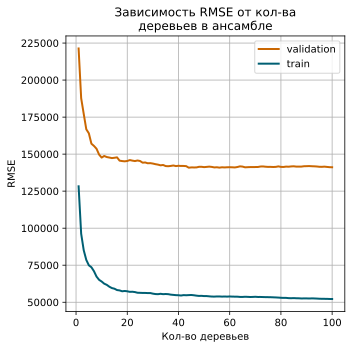

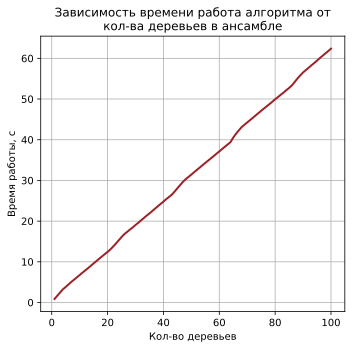

In [38]:
tree_params = {
    'max_features': X_train.shape[1] // 2,
    'max_depth': 20
}

examine_trees_amount(
    RandomForestMSE,
    100, tree_params,
    save=True,
    filename='rf_ntrees'
)

## .2 Размерность подвыборки признаков для одной вершины дерева

100%|██████████| 7/7 [04:17<00:00, 36.78s/it]


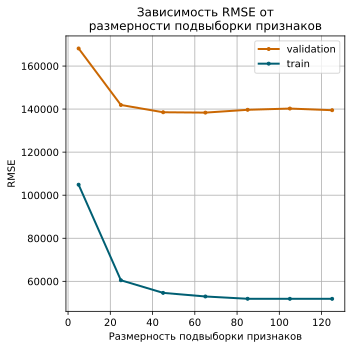

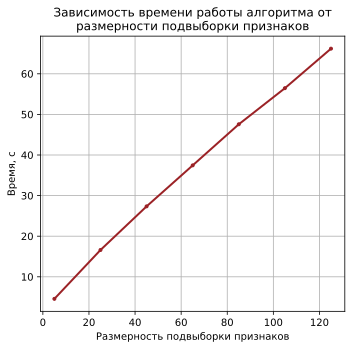

In [233]:
maxf_grid = np.arange(5, X_train.shape[1], 20)
tree_params = {
    'max_features': X_train.shape[1] // 2,
    'max_depth': 20
}

examine(
    model_class=RandomForestMSE,
    ntrees=50,
    grid=maxf_grid,
    name='max_features',
    tree_params=tree_params,
    save=True,
    filename='rf_maxf',
    xlabel='Размерность подвыборки признаков',
    title='размерности подвыборки признаков'
)

## .3 Максимальная глубина дерева

100%|██████████| 14/14 [04:10<00:00, 17.89s/it]


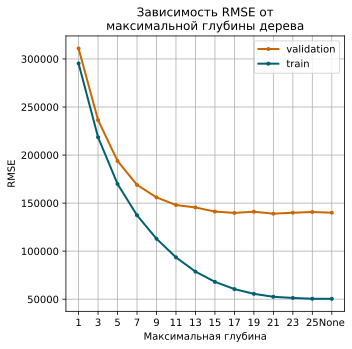

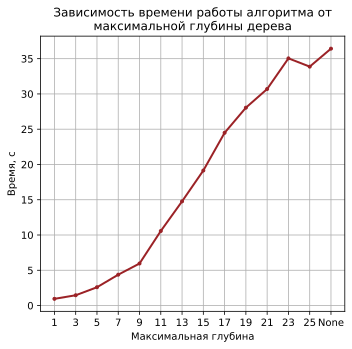

In [239]:
depth_grid = list(np.arange(1, 26, 2)) + [None]
tree_params = {
    'max_features': 50,
    'max_depth': 20
}

examine(
    model_class=RandomForestMSE,
    ntrees=50,
    grid=depth_grid,
    name='max_depth',
    tree_params=tree_params,
    save=True,
    filename='rf_maxd',
    xlabel='Максимальная глубина',
    title='максимальной глубины дерева'
)

# Эксперименты с бустингом

## .1 Количество деревьев в ансамбле

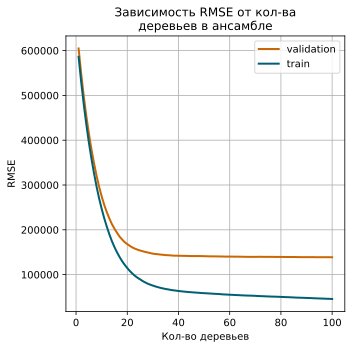

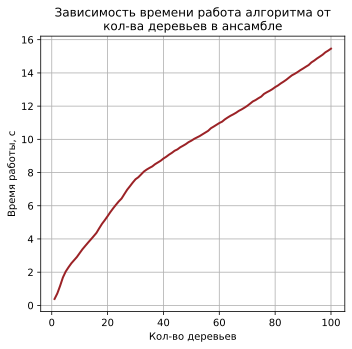

In [41]:
tree_params = {
    'max_features': 100,
    'max_depth': 10
}

examine_trees_amount(
    GradientBoostingMSE,
    100,
    tree_params,
    save=True,
    filename='gb_ntrees'
)

## .2 Размерность подвыборки признаков для одной вершины дерева

100%|██████████| 30/30 [03:04<00:00,  6.16s/it]


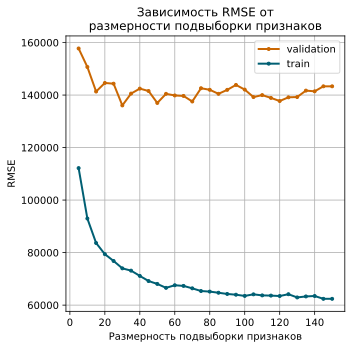

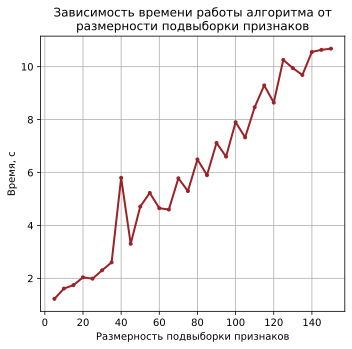

In [42]:
maxf_grid = np.arange(5, 151, 5)
tree_params = {
    'max_features': X_train.shape[1] // 2,
    'max_depth': 10
}

examine(
    model_class=GradientBoostingMSE,
    ntrees=40,
    grid=maxf_grid,
    name='max_features',
    tree_params=tree_params,
    save=True,
    filename='gb_maxf',
    xlabel='Размерность подвыборки признаков',
    title='размерности подвыборки признаков'
)

## .3 Максимальная глубина дерева

100%|██████████| 11/11 [01:00<00:00,  5.54s/it]


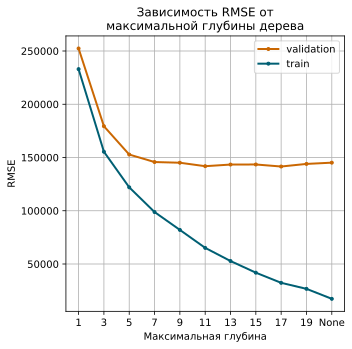

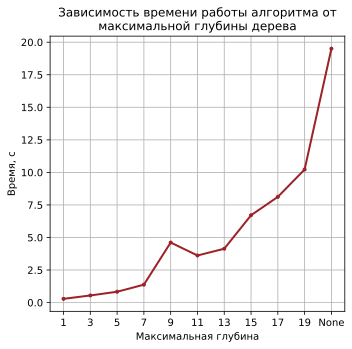

In [43]:
depth_grid = list(np.arange(1, 20, 2)) + [None]
tree_params = {
    'max_features': 30,
    'max_depth': 10
}

examine(
    model_class=GradientBoostingMSE,
    ntrees=40,
    grid=depth_grid,
    name='max_depth',
    tree_params=tree_params,
    save=True,
    filename='gb_maxd',
    xlabel='Максимальная глубина',
    title='максимальной глубины дерева'
)

## .4 Коэффициент скорости обучения

100%|██████████| 6/6 [00:12<00:00,  2.08s/it]


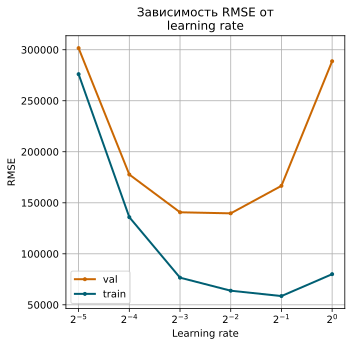

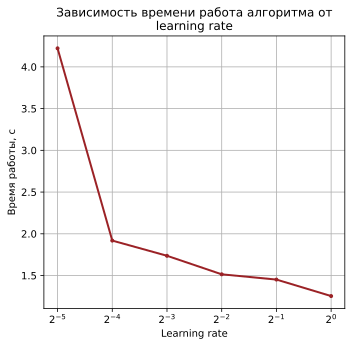

In [45]:
lr_grid = 2.0 ** np.arange(-5, 1)
tree_params = {
    'max_features': 30,
    'max_depth': 10
}

lr_train_res = list()
lr_val_res = list()
lr_time_res = list()

for param in tqdm(lr_grid):
    clf = GradientBoostingMSE(30, learning_rate=param, tree_params=tree_params)
    hist, times = clf.fit(X_train, y_train, X_val, y_val, trace=True)
    lr_val_res.append(hist['val'][-1])
    lr_train_res.append(hist['train'][-1])
    lr_time_res.append(np.sum(times))

plt.figure(figsize=(5, 5))
plt.title('Зависимость RMSE от\nlearning rate')
xticks = [param if param is not None else 'None' for param in lr_grid]
plt.plot(xticks, lr_val_res, label='val', marker='.', color='#CA6702', linewidth=2)
plt.plot(xticks, lr_train_res, label='train', marker='.', color='#005F73', linewidth=2)
plt.xlabel('Learning rate')
plt.ylabel('RMSE')
plt.xscale('log', base=2)
plt.grid(True)
plt.legend()
plt.tight_layout()
plt.savefig('gb_lr_rmse.pdf')
plt.show()

plt.figure(figsize=(5, 5))
plt.title('Зависимость времени работа алгоритма от\nlearning rate')
plt.plot(xticks, lr_time_res, marker='.', color='#9B2226', linewidth=2)
plt.xlabel('Learning rate')
plt.ylabel('Время работы, с')
plt.xscale('log', base=2)
plt.grid(True)
plt.tight_layout()
plt.savefig('gb_lr_time.pdf')
plt.show()